# Dimensionality reduction on trial features

In [1]:

""" 
IMPORTS
"""
import os
import autograd.numpy as np
import pickle
import seaborn as sns
from collections import defaultdict
import pandas as pd
from matplotlib import colors as mcolors
from one.api import ONE
from pprint import pprint
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, Normalizer
import collections

# --Machine learning and statistics
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer
from sklearn.cluster import KMeans
import umap

# Get my functions
functions_path =  '/home/ines/repositories/representation_learning_variability/Models/Sub-trial//2_fit_models/'
functions_path = '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability//Models/Sub-trial//2_fit_models/'
os.chdir(functions_path)
from preprocessing_functions import concatenate_sessions, fix_discontinuities
functions_path =  '/home/ines/repositories/representation_learning_variability/Models/Sub-trial//3_postprocess_results/'
functions_path = '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability//Models/Sub-trial//3_postprocess_results/'
os.chdir(functions_path)
from postprocessing_functions import remove_states_str, state_identifiability
from plotting_functions import align_bin_design_matrix, states_per_trial_phase, broader_label, traces_over_few_sates

# one = ONE(base_url='https://alyx.internationalbrainlab.org')
one = ONE(mode='remote')

## Parameters

In [2]:
bin_size = 0.1
multiplier = 1/bin_size

event_type_list = ['goCueTrigger_times']  # , 'feedback_times', 'firstMovement_times'
event_type_name = ['Go cue']  # , 'Feedback time', 'First movement onset'

num_train_batches = 5
threshold = 0.05
sticky = False

# Values for grid search (should get this from results)
last_lag = 20
lag_step = 2
start_lag = 1
Lags = list(range(start_lag, last_lag, lag_step))
kappas = [0, 1, 5, 10, 100, 500, 1000, 2000, 5000, 7000, 10000]


## Get data

In [3]:
# Load preprocessed data
prepro_results_path =  '/home/ines/repositories/representation_learning_variability/DATA/Sub-trial/Results/' + str(bin_size) + '/'
os.chdir(prepro_results_path)
idxs, mouse_names, matrix_all, matrix_all_unnorm, session_all = pickle.load(open(prepro_results_path + "preprocessed_data_v4_170724", "rb"))
collapsed_matrices, collapsed_unnorm, collapsed_trials = concatenate_sessions (mouse_names, matrix_all, matrix_all_unnorm, session_all)

## Plot combined states per animal

In [4]:
use_sets = [['avg_wheel_vel'], ['Lick count'], ['whisker_me'],
            ['left_X', 'left_Y', 'right_X', 'right_Y'], ['nose_X', 'nose_Y']]
use_sets = [['avg_wheel_vel'], ['Lick count'], ['whisker_me'],
            ['left_X', 'left_Y', 'right_X', 'right_Y']]
use_sets = [['avg_wheel_vel'], ['Lick count'], ['whisker_me']]
var_interest_map = ['avg_wheel_vel', 'Lick count', 'whisker_me', 'left_X', 'nose_X']
idx_init_list = [0, 1, 2, 3, 7]
idx_end_list = [1, 2, 3, 7, 9]

## Loop through sessions a prepare data

In [5]:
exclude_sessions = ['f1db6257-85ef-4385-b415-2d078ec75df2',
'259927fd-7563-4b03-bc5d-17b4d0fa7a55',
'e49d8ee7-24b9-416a-9d04-9be33b655f40',
'6f6d2c8e-28be-49f4-ae4d-06be2d3148c1',
'193fe7a8-4eb5-4f3e-815a-0c45864ddd77',
'f8d5c8b0-b931-4151-b86c-c471e2e80e5d',
'ebc9392c-1ecb-4b4b-a545-4e3d70d23611',
'537677fe-1e24-4755-948c-fa4a4e8ecce5',
'a4747ac8-6a75-444f-b99b-696fff0243fd',
'7be8fec4-406b-4e74-8548-d2885dcc3d5e',
'a71175be-d1fd-47a3-aa93-b830ea3634a1',
'53738f95-bd08-4d9d-9133-483fdb19e8da',
'd901aff5-2250-467a-b4a1-0cb9729df9e2',
'7939711b-8b4d-4251-b698-b97c1eaa846e',
'510b1a50-825d-44ce-86f6-9678f5396e02',
'aad23144-0e52-4eac-80c5-c4ee2decb198',
'd839491f-55d8-4cbe-a298-7839208ba12b',
'72cb5550-43b4-4ef0-add5-e4adfdfb5e02']

In [6]:
states_trial_type = pd.DataFrame(columns=['mouse_name', 'session', 'correct', 'choice', 'contrast', 
                                          'reaction', 'response', 'elongation', 'most_likely_states', 
                                          'identifiable_states', 'Bin', 'label'])
for m, mat in enumerate(idxs):
    if len(mat) > 35: 
        # try:
        mouse_name = mat[37:]
        session = mat[0:36]
        
        if session not in exclude_sessions:
            var_names = ['avg_wheel_vel', 'Lick count', 'whisker_me']

            # Get mouse data          
            session_trials = session_all[mouse_name][session]
            session_trials = session_trials.reset_index()
            design_matrix = matrix_all[mouse_name][session][:,0:3]
            unnorm_mat = matrix_all_unnorm[mouse_name][session][var_names]
            unnorm_mat['Bin'] = matrix_all_unnorm[mouse_name][session]['Bin']

            # Get states per variable and concatenate
            states_path =  '/home/ines/repositories/representation_learning_variability/DATA/Sub-trial/Results/' + str(bin_size) + '/most_likely_states/'
            os.chdir(states_path)

            c_states = []
            for s, set in enumerate(use_sets):
                
                most_likely_states, _ = pickle.load(open("most_likely_states" + set[0] + '_' + mouse_name + session, "rb"))
                # Save
                if len(c_states) == 0:
                    c_states = most_likely_states
                else:
                    c_states = np.vstack((c_states, most_likely_states))      
            
            combined_states = remove_states_str(c_states.T, threshold)
            
            " Prepare data "
            num_timesteps = np.shape(design_matrix)[0]
            design_matrix_heading = pd.DataFrame(columns=var_names)
            design_matrix_heading[var_names] = design_matrix[0:len(combined_states)]  # TODO: need to understand why number is the same and whether it depends on lag
            bins = unnorm_mat[:(num_timesteps // num_train_batches) * num_train_batches]['Bin']
            design_matrix_heading['Bin'] = bins
            design_matrix_heading['Lick count'] = unnorm_mat[:(num_timesteps // num_train_batches) * num_train_batches]['Lick count']
            
            # Transform states into identifiable states
            identifiable_states = state_identifiability(combined_states, design_matrix_heading)
            
            # Change states back to integer
            state_labels = np.unique(identifiable_states)
            int_state = np.arange(0, len(state_labels), 1).astype(float)
            if state_labels[-1] == 'nan':
                int_state[-1] = np.nan
            # Define the mapping as a dictionary
            mapping = {unique: key for unique, key in zip(state_labels, int_state)}
            inverted_mapping = {v: k for k, v in mapping.items()}

            # Use np.vectorize to apply the mapping
            replace_func = np.vectorize(mapping.get)
            new_states = replace_func(identifiable_states)
            num_states = len(np.unique(new_states))

            # Align bins
            init = -1 * multiplier
            end = 1.5 * multiplier
            empirical_data = align_bin_design_matrix(init, end, event_type_list, session_trials, design_matrix_heading, new_states, multiplier)
            empirical_data['identifiable_states'] = identifiable_states
            
            """ Trial types """
            # Split in trial types
            states_trial = states_per_trial_phase(empirical_data, session_trials, multiplier)
            states_trial['mouse_name'] = mouse_name
            states_trial['session'] = session
            replace_func = np.vectorize(inverted_mapping.get)
            str_states = replace_func(np.array(states_trial['most_likely_states']))
            states_trial['identifiable_states'] = str_states
            states_trial = broader_label(states_trial)
            
            # Save to big df
            if len(states_trial_type) == 0:
                states_trial_type = states_trial.copy()
            else:
                states_trial_type = states_trial_type.append(states_trial)
                
        else:
            print(session)


/tmp/ipykernel_7447/1831453200.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unnorm_mat['Bin'] = matrix_all_unnorm[mouse_name][session]['Bin']
/home/ines/repositories/representation_learning_variability/Functions/one_functions_generic.py:530: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trials['prev_choice'][1:] = trials['choice'][:-1]
/home/ines/repositories/representation_learning_variability/Functions/one_functions_generic.py:532: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the document

72cb5550-43b4-4ef0-add5-e4adfdfb5e02


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

d839491f-55d8-4cbe-a298-7839208ba12b


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

aad23144-0e52-4eac-80c5-c4ee2decb198


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

510b1a50-825d-44ce-86f6-9678f5396e02


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

7939711b-8b4d-4251-b698-b97c1eaa846e


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

d901aff5-2250-467a-b4a1-0cb9729df9e2
53738f95-bd08-4d9d-9133-483fdb19e8da


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

a71175be-d1fd-47a3-aa93-b830ea3634a1


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

7be8fec4-406b-4e74-8548-d2885dcc3d5e


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

a4747ac8-6a75-444f-b99b-696fff0243fd


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

537677fe-1e24-4755-948c-fa4a4e8ecce5


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

ebc9392c-1ecb-4b4b-a545-4e3d70d23611


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

f8d5c8b0-b931-4151-b86c-c471e2e80e5d


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

193fe7a8-4eb5-4f3e-815a-0c45864ddd77


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

6f6d2c8e-28be-49f4-ae4d-06be2d3148c1


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

e49d8ee7-24b9-416a-9d04-9be33b655f40


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

259927fd-7563-4b03-bc5d-17b4d0fa7a55


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

f1db6257-85ef-4385-b415-2d078ec75df2


/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:219: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  quiescence_states = quiescence_states.append(quiescence_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:227: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  correct_states = correct_states.append(correct_data[['correct', 'choice', 'contrast',
/home/ines/repositories/representation_learning_variability/Models/Sub-trial/3_postprocess_results/plotting_functions.py:233: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ITI_states_correct = ITI_states_corr

In [4]:
saved = states_trial_type.copy()

In [59]:
def groupby(vars, use_data):
    # Step 1: Group and count occurrences
    count = pd.DataFrame(use_data.groupby(vars)['identifiable_states'].count())  #  'correct',

    # Step 2: Reset index to bring the grouping columns back into the DataFrame
    count = count.reset_index(level=list(np.arange(0, len(vars)-1, 1)))

    # Rename the count column
    count.rename(columns={'identifiable_states': 'count'}, inplace=True)

    # Step 3: Calculate the total counts for each group of 'mouse_name', 'session', 'label'
    count['total'] = count.groupby(vars[:-1])['count'].transform('sum')  # 'broader_label'

    # Step 4: Compute the relative frequency
    count['relative_frequency'] = count['count'] / count['total']

    # Drop the 'total' column if it's no longer needed
    count = count.drop(columns=['total'])

    return count


# Compute features and organize sample keys

In [60]:
trial_type_agg = ['wsls', 'correct_str', 'choice', 'contrast_str']
trial_type_agg = ['correct_str', 'contrast_str', 'wsls', 'choice']
trial_type_agg = ['correct_str', 'contrast_str', 'wsls']
trial_type_agg = ['correct_str', 'perseverence']
# trial_type_agg = ['wsls']


order_0 = ['left', 'right']
order_1 = ['correct', 'incorrect']
order_1_1 = ['1.0',
    '0.25', 
    '0.125', 
    '0.0625', 
    '0.0']
order_1_2 = ['wst',
    'lst', 
    'wsh', 
    'lsh']


order_2 = ['correct 1.0',
    'correct 0.25', 
    'correct 0.125', 
    'correct 0.0625', 
    'correct 0.0', 
    'incorrect 1.0', 
    'incorrect 0.25', 
    'incorrect 0.125', 
    'incorrect 0.0625', 
    'incorrect 0.0']
order_2_1 = ['correct 1.0',
    'correct 0.25', 
    'correct 0.125', 
    'correct 0.0625', 
    'correct 0.0', 
    'incorrect 0.0', 
    'incorrect 0.0625', 
    'incorrect 0.125', 
    'incorrect 0.25', 
    'incorrect 1.0']
order_3 = ['correct 1.0 left', 'correct 1.0 right', 
    'correct 0.25 left', 'correct 0.25 right',
    'correct 0.125 left', 'correct 0.125 right',
    'correct 0.0625 left', 'correct 0.0625 right',
    'correct 0.0 left', 'correct 0.0 right',
    'incorrect 1.0 left', 'incorrect 1.0 right', 
    'incorrect 0.25 left', 'incorrect 0.25 right',
    'incorrect 0.125 left', 'incorrect 0.125 right',
    'incorrect 0.0625 left', 'incorrect 0.0625 right',
    'incorrect 0.0 left', 'incorrect 0.0 right']

order_4 = ['correct 1.0 wst', 'correct 1.0 wsh', 'correct 1.0 lst', 'correct 1.0 lsh', 
    'correct 0.25 wst', 'correct 0.25 wsh', 'correct 0.25 lst', 'correct 0.25 lsh', 
    'correct 0.125 wst', 'correct 0.125 wsh', 'correct 0.125 lst', 'correct 0.125 lsh',
    'correct 0.0625 wst', 'correct 0.0625 wsh',   'correct 0.0625 lst', 'correct 0.0625 lsh',
    'correct 0.0 wst', 'correct 0.0 wsh', 'correct 0.0 lst', 'correct 0.0 lsh',
    'incorrect 1.0 wst', 'incorrect 1.0 wsh',  'incorrect 1.0 lst', 'incorrect 1.0 lsh', 
    'incorrect 0.25 wst', 'incorrect 0.25 wsh', 'incorrect 0.25 lst', 'incorrect 0.25 lsh',
    'incorrect 0.125 wst', 'incorrect 0.125 wsh', 'incorrect 0.125 lst', 'incorrect 0.125 lsh',
    'incorrect 0.0625 wst', 'incorrect 0.0625 wsh',  'incorrect 0.0625 lst', 'incorrect 0.0625 lsh',
    'incorrect 0.0 wst', 'incorrect 0.0 wsh', 'incorrect 0.0 lst', 'incorrect 0.0 lsh']

order_5 = ['correct wst', 'correct lst', 'correct wsh', 'correct lsh',
    'incorrect wst', 'incorrect lst',  'incorrect wsh', 'incorrect lsh']

order_6 = ['correct stay', 'correct shift',
    'incorrect stay', 'incorrect shift']

use_order = order_6

In [7]:
""" Define trial types"""
states_trial_type['correct_str'] = states_trial_type['correct']
states_trial_type.loc[states_trial_type['correct_str']==1., 'correct_str'] = 'correct'
states_trial_type.loc[states_trial_type['correct_str']==0., 'correct_str'] = 'incorrect'
states_trial_type['contrast_str'] = states_trial_type['contrast'].astype(str)
states_trial_type['perseverence'] = states_trial_type['wsls'].copy()
states_trial_type.loc[states_trial_type['wsls'].isin(['wst', 'lst']), 'perseverence']  = 'stay'
states_trial_type.loc[states_trial_type['wsls'].isin(['wsh', 'lsh']), 'perseverence']  = 'shift'
states_trial_type['trial_type'] = states_trial_type[trial_type_agg].agg(' '.join, axis=1)
states_trial_type['trial_str'] = states_trial_type['trial_id'].astype(str)
states_trial_type['sample'] = states_trial_type[['session', 'trial_str']].agg(' '.join, axis=1)

""" Sort in intuitive way to help with visualization """

""" Frequency """
vars = ['sample', 'trial_type', 'broader_label', 'mouse_name']
extended_vars = ['sample', 'trial_type', 'broader_label', 'mouse_name', 'identifiable_states']
count = groupby(extended_vars, states_trial_type)

# Pivot the DataFrame
freq_df = count.reset_index().pivot(index=['sample', 'trial_type', 'mouse_name'], columns=['identifiable_states', 'broader_label'], values='relative_frequency')
# To flatten the column MultiIndex
freq_df.columns = ['_'.join(col).strip() for col in freq_df.columns.values]
freq_df[freq_df.isna()] = 0

""" Timings """
times = pd.DataFrame(states_trial_type.groupby(['sample', 'trial_type', 'mouse_name'])['reaction', 'response', 'elongation'].mean()).reset_index()

# Merge
merged_df = freq_df.merge(times, on=['sample', 'trial_type', 'mouse_name'])

/var/folders/nt/d2j3zp9d1xzb8wgfrw81j0c40000gn/T/ipykernel_82922/1640269079.py:27: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  times = pd.DataFrame(states_trial_type.groupby(['sample', 'trial_type', 'mouse_name'])['reaction', 'response', 'elongation'].mean()).reset_index()


## Prepare design matrix

In [8]:
var_names = ['000_Quiescence', '000_Stimulus', '111_Choice',
       '011_ITI', '111_ITI', '011_Quiescence', '101_Quiescence',
       '101_Stimulus', '011_Stimulus', '000_ITI', '100_ITI', '101_ITI',
       '111_Quiescence', '111_Stimulus', '100_Stimulus', '000_Choice',
       '100_Choice', '011_Choice', '101_Choice', '100_Quiescence',
       '001_Quiescence', '001_ITI', '001_Stimulus', '001_Choice', '110_ITI',
       '110_Choice', '110_Quiescence', '110_Stimulus', '010_ITI', '010_Choice',
       '010_Quiescence', '010_Stimulus', 'Choice', 'ITI', 'Quiescence',
       'Stimulus', 'reaction', 'response', 'elongation']

var_names = ['000_Quiescence', '000_Stimulus', '111_Choice',
       '011_ITI', '111_ITI', '011_Quiescence', '101_Quiescence',
       '101_Stimulus', '011_Stimulus', '000_ITI', '100_ITI', '101_ITI',
       '111_Quiescence', '111_Stimulus', '100_Stimulus', '000_Choice',
       '100_Choice', '011_Choice', '101_Choice', '100_Quiescence',
       '001_Quiescence', '001_ITI', '001_Stimulus', '001_Choice', '110_ITI',
       '110_Choice', '110_Quiescence', '110_Stimulus', '010_ITI', '010_Choice',
       '010_Quiescence', '010_Stimulus', 'reaction', 'response', 'elongation']

ori_X = np.array(merged_df[var_names]) #.values

## UMAP

In [9]:
reducer = umap.UMAP(random_state= 42)

# Standardization using StandardScaler
scaler = StandardScaler()
standardized_X = scaler.fit_transform(ori_X)

embedding = reducer.fit_transform(standardized_X)
embedding.shape

/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


(9998, 2)

In [10]:
merged_df['session'] = merged_df['sample'].str[:36]
use_key = 'trial_type' # session trial_type

unique_numeric_labels = np.arange(0, len(use_order), 1)
map_to_use = dict(zip(use_order, unique_numeric_labels))

# Apply map
unique_trial_types = merged_df[use_key].unique()
# trial_type_map = dict(zip(unique_trial_types, unique_numeric_labels))
merged_df['numeric_trial_code'] = merged_df[use_key].map(map_to_use)

# Mouse names in number for color code
unique_mouse_labels = np.arange(0, len(merged_df['mouse_name'].unique()), 1)
map_mouse_names = dict(zip(merged_df['mouse_name'].unique(), unique_mouse_labels))
mouse_name_numbers = merged_df['mouse_name'].map(map_mouse_names)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Text(0, 0.5, 'UMAP 2')

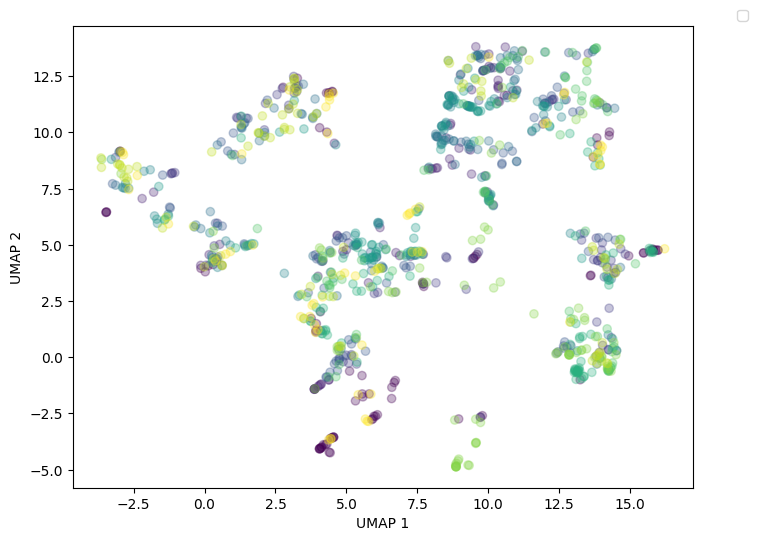

In [11]:
plt.figure(figsize=(8, 6))

scatter = plt.scatter(
    embedding[:, 0][0:1000],
    embedding[:, 1][0:1000],
    alpha=0.3,
    c=mouse_name_numbers[0:1000],
    cmap='viridis'  # Choose a colormap
)   #     c=mouse_name_numbers,

# # Create the custom legend
# handles = []
# for code, label in zip(unique_numeric_labels, use_order):
#     handles.append(plt.Line2D([], [], marker='o', color=scatter.cmap(scatter.norm(code)), linestyle='', label=label))

plt.legend(bbox_to_anchor=(1.1, 1.05))
# plt.legend(handles=handles, title="Trial type", bbox_to_anchor=(1.1, 1.05))
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
# plt.xlim([-15, 25])
# plt.gca().set_aspect('equal', 'datalim')


Text(0, 0.5, 'UMAP 2')

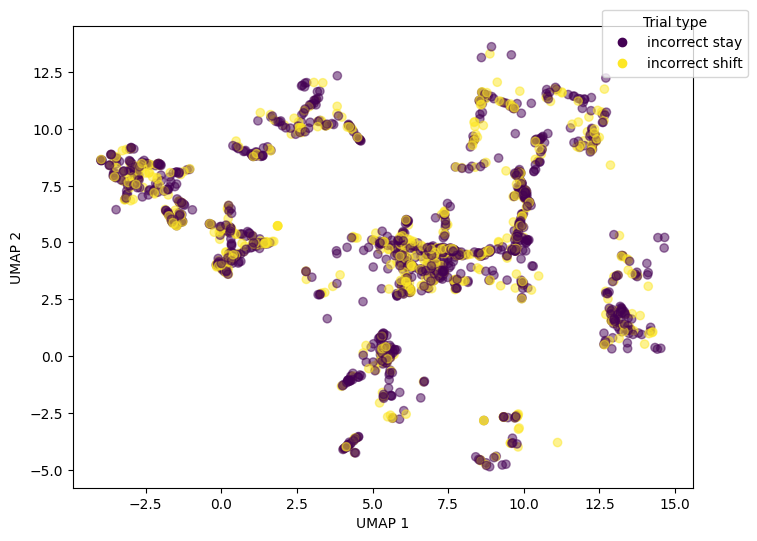

In [12]:
plt.figure(figsize=(8, 6))
filter = merged_df['trial_type'].isin(['incorrect stay', 'incorrect shift'])

# Plotting the scatter plot
scatter = plt.scatter(
    embedding[:, 0][filter],
    embedding[:, 1][filter],
    c=merged_df.loc[merged_df['trial_type'].isin(['incorrect stay', 'incorrect shift']), 'numeric_trial_code'],
    alpha=0.5,
    cmap='viridis'  # Choose a colormap
)  

# Create the custom legend
handles = []
for code, label in zip(unique_numeric_labels[2:], use_order[2:]):
    handles.append(plt.Line2D([], [], marker='o', color=scatter.cmap(scatter.norm(code)), linestyle='', label=label))

# x.legend(bbox_to_anchor=(1.1, 1.05))
plt.legend(handles=handles, title="Trial type", bbox_to_anchor=(1.1, 1.05))
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
# plt.xlim([-15, 25])
# plt.gca().set_aspect('equal', 'datalim')



## K-means clustering of data

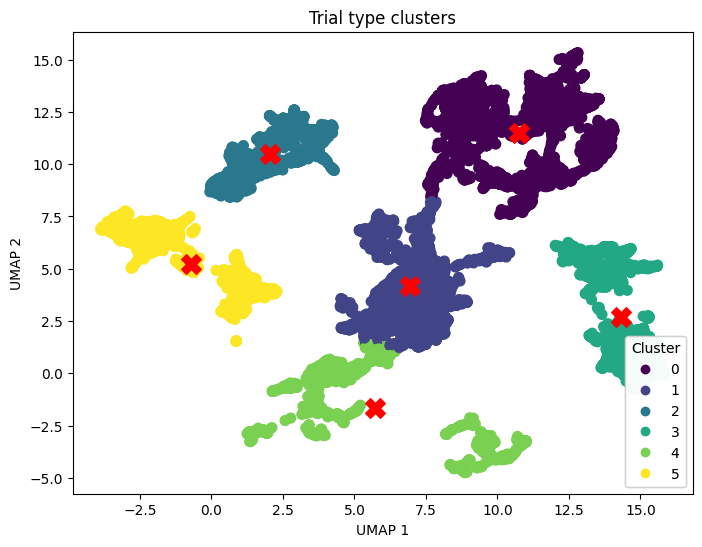

In [114]:
# Step 2: Perform KMeans Clustering
data_2d = embedding
kmeans = KMeans(n_clusters=6, random_state=2024)
kmeans.fit(data_2d)
y_kmeans = kmeans.predict(data_2d)

# Step 3: Plot the clusters
fig, ax = plt.subplots(figsize=(8, 6))

# Plot each cluster with a different color
scatter = ax.scatter(data_2d[:, 0], data_2d[:, 1], c=y_kmeans, s=50, cmap='viridis')

# Plot the centroids
centroids = kmeans.cluster_centers_
dots = ax.scatter(centroids[:, 0], centroids[:, 1], s=200, c='red', marker='X')

# produce a legend with the unique colors from the scatter
legend1 = ax.legend(*scatter.legend_elements(),
                    loc="lower right", title="Cluster")
ax.add_artist(legend1)

plt.title("Trial type clusters")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


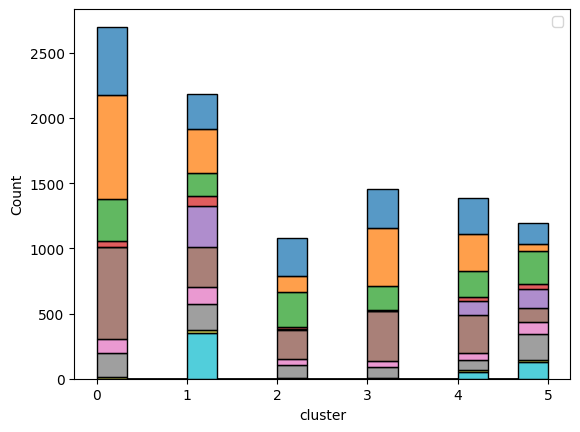

In [24]:
merged_df['cluster'] = y_kmeans
sns.histplot(x='cluster', hue='trial_type', data=merged_df, multiple='stack')
plt.legend()

In [17]:
# Analyze state features
merged_df['cluster'] = y_kmeans
df_cluster = count.reset_index().merge(merged_df[['sample', 'cluster']], on='sample')
# df_cluster = df_cluster.merge(sum[['sample', 'broader_label', 'sum']], on=['sample', 'broader_label'])
df_cluster = df_cluster.merge(times[['sample', 'reaction', 'response', 
                                     'elongation']], on=['sample'])

/tmp/ipykernel_7447/3641596897.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  use_data['trial_type'] = pd.Categorical(use_data['trial_type'], categories = order_2)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


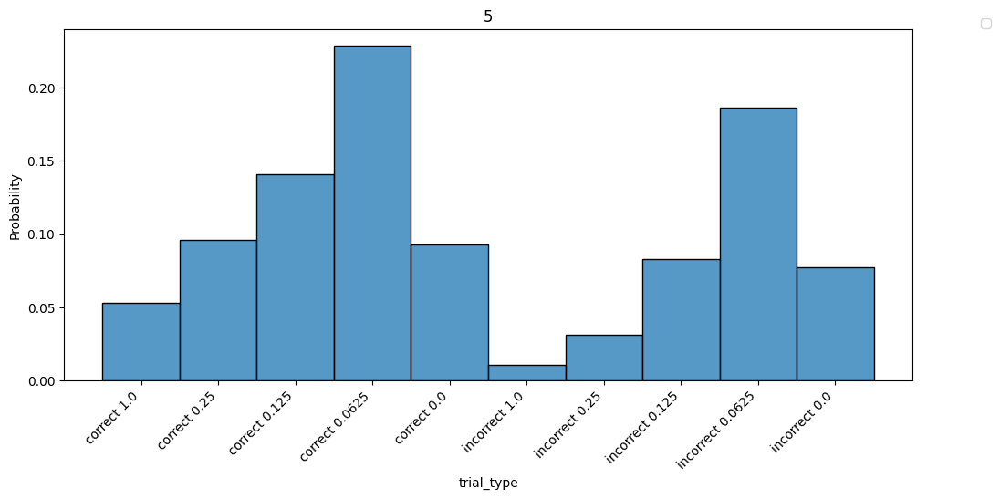

/tmp/ipykernel_7447/3641596897.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  use_data['trial_type'] = pd.Categorical(use_data['trial_type'], categories = order_2)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


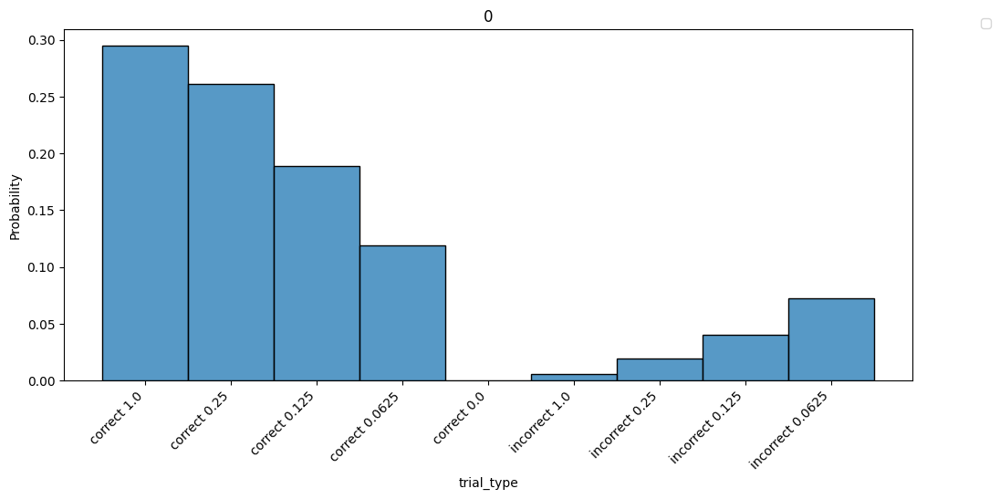

/tmp/ipykernel_7447/3641596897.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  use_data['trial_type'] = pd.Categorical(use_data['trial_type'], categories = order_2)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


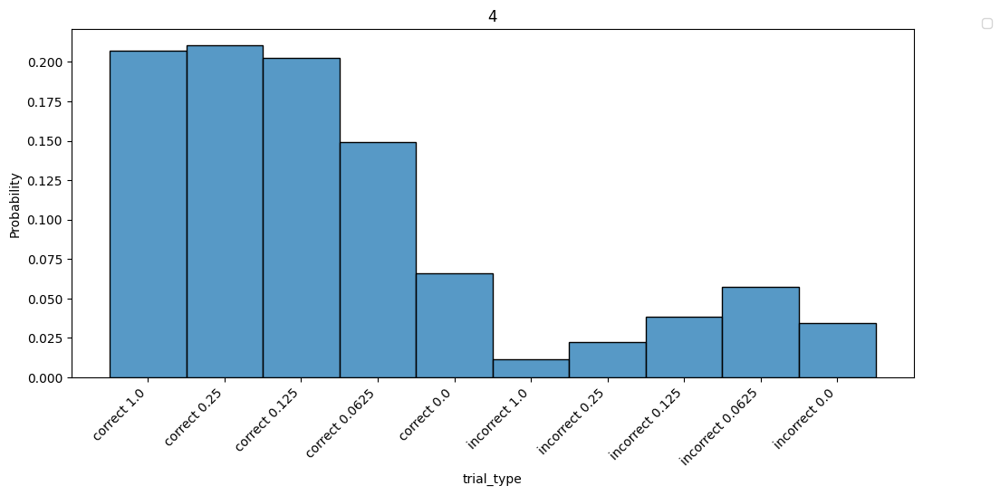

/tmp/ipykernel_7447/3641596897.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  use_data['trial_type'] = pd.Categorical(use_data['trial_type'], categories = order_2)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


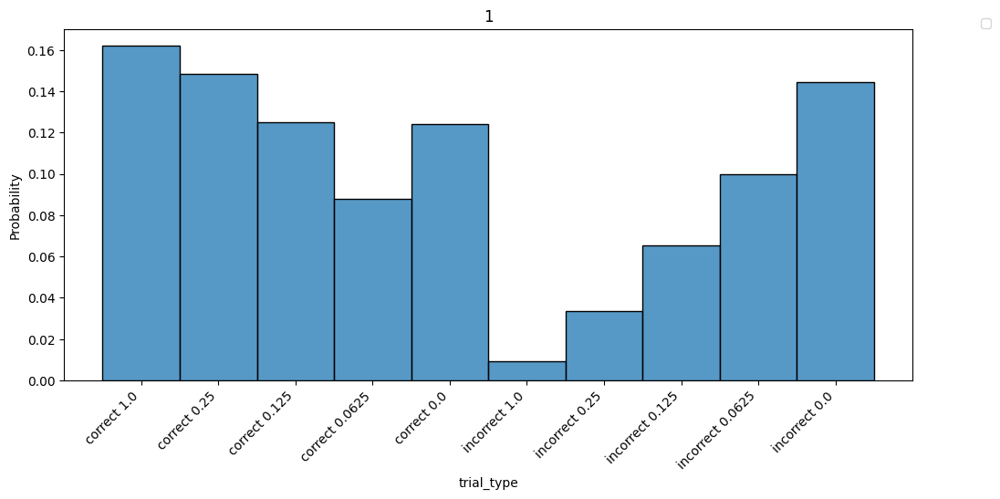

/tmp/ipykernel_7447/3641596897.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  use_data['trial_type'] = pd.Categorical(use_data['trial_type'], categories = order_2)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


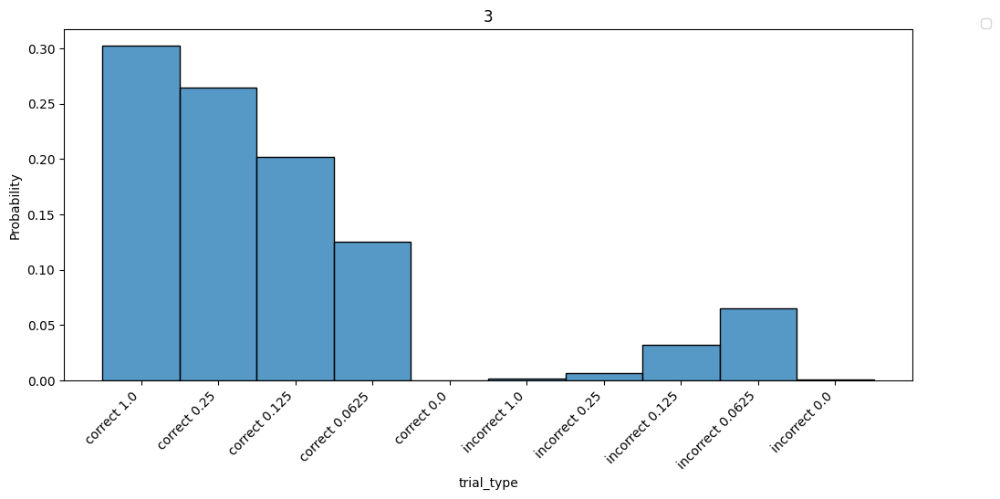

/tmp/ipykernel_7447/3641596897.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  use_data['trial_type'] = pd.Categorical(use_data['trial_type'], categories = order_2)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


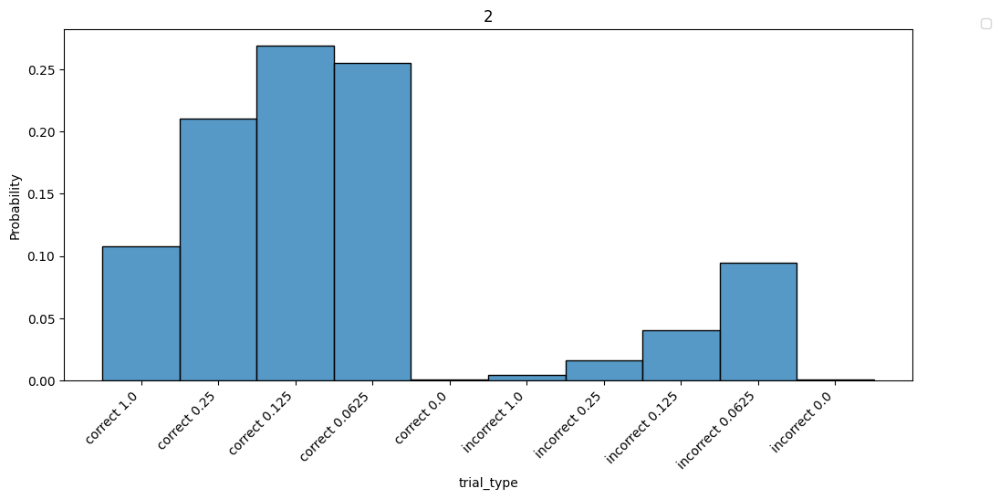

In [26]:
for c, cluster in enumerate(df_cluster['cluster'].unique()):
    use_data = df_cluster.loc[df_cluster['cluster']==cluster]
    fig, ax = plt.subplots(figsize=(12, 5))

    use_data['trial_type'] = pd.Categorical(use_data['trial_type'], categories = order_2)
    sns.histplot(x='trial_type', data=use_data, stat='probability')
    plt.xticks(rotation=45, ha='right')
    plt.legend(bbox_to_anchor=(1.1, 1.05))
    plt.title(cluster)
    plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


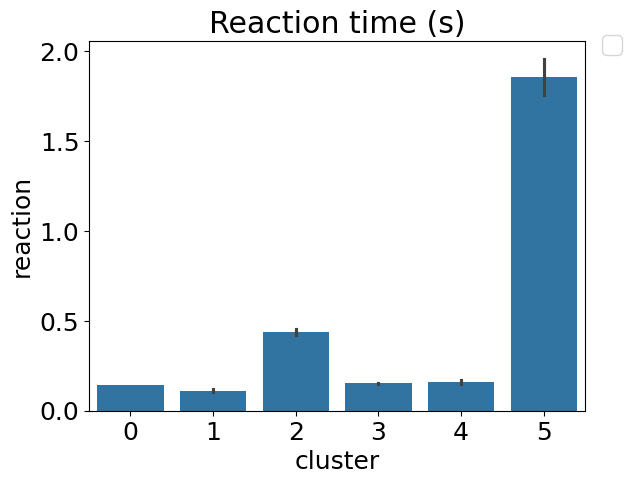

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


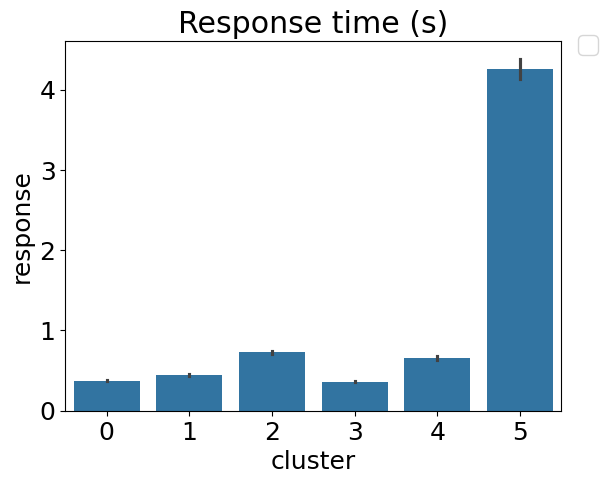

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


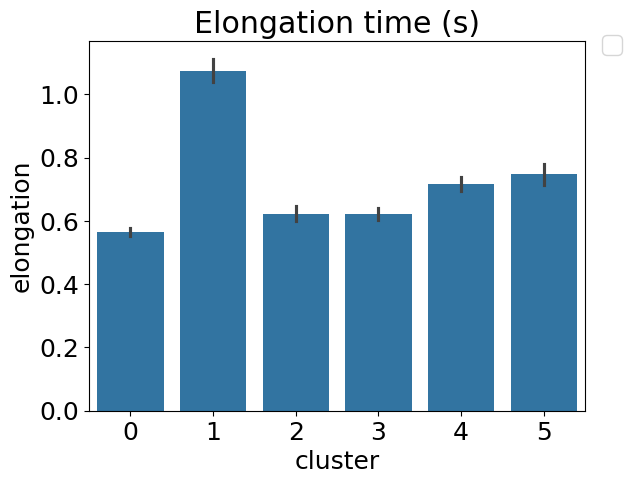

In [344]:
sns.barplot(x='cluster', y='reaction', data=df_cluster)
plt.legend(bbox_to_anchor=(1.1, 1.05))
plt.title('Reaction time (s)')
plt.show()

sns.barplot(x='cluster', y='response', data=df_cluster)
plt.legend(bbox_to_anchor=(1.1, 1.05))
plt.title('Response time (s)')
plt.show()

sns.barplot(x='cluster', y='elongation', data=df_cluster)
plt.legend(bbox_to_anchor=(1.1, 1.05))
plt.title('Elongation time (s)')
plt.show()


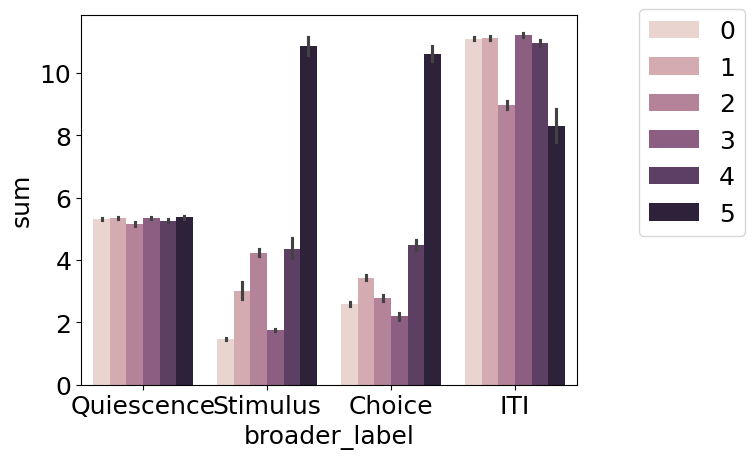

In [333]:
sns.barplot(x='broader_label', y='sum', hue='cluster', data=df_cluster)
plt.legend(bbox_to_anchor=(1.1, 1.05))

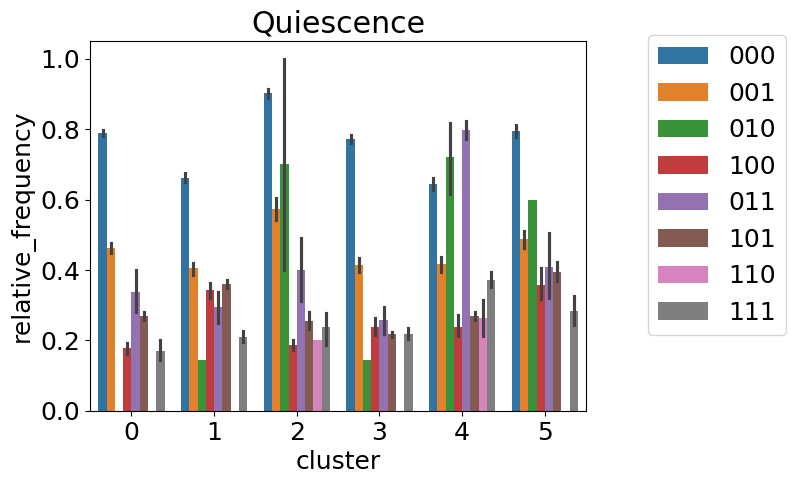

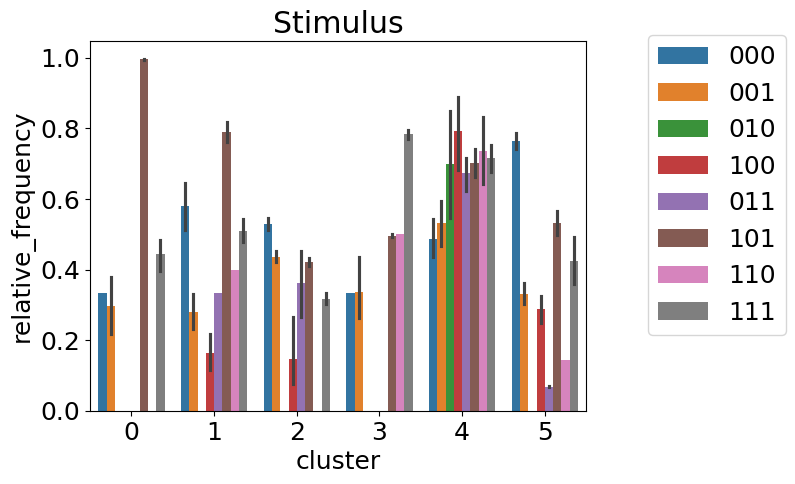

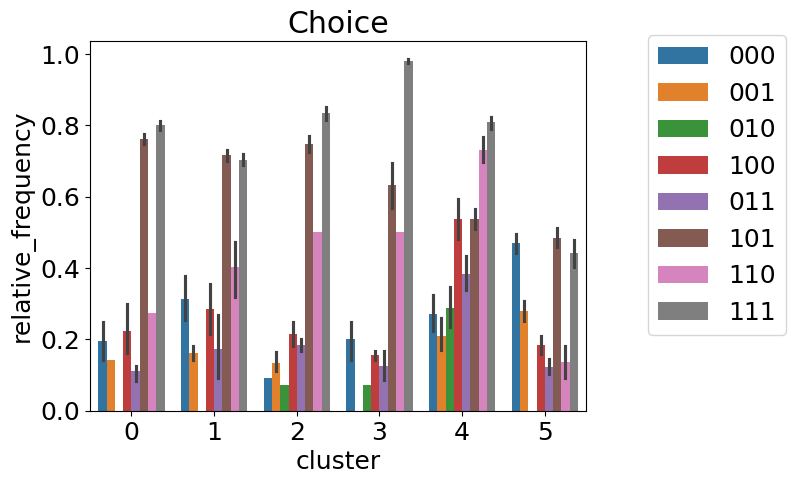

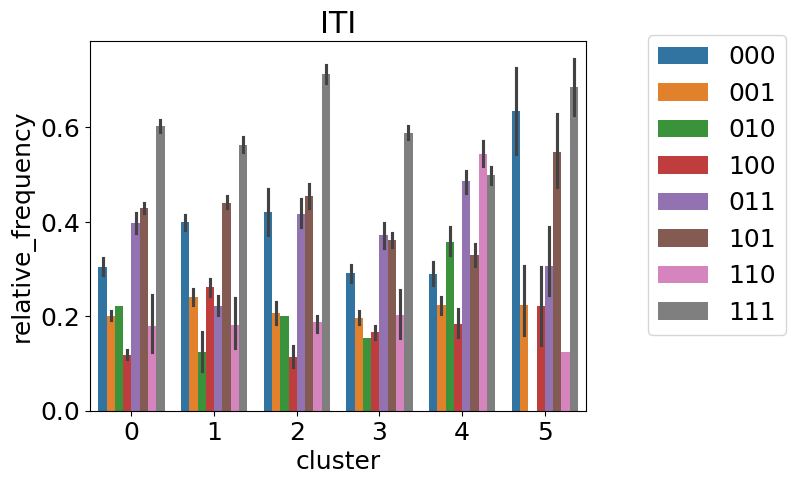

In [345]:
for e, epoch in enumerate(df_cluster['broader_label'].unique()):
    use_data = df_cluster.loc[df_cluster['broader_label']==epoch]
    sns.barplot(hue='identifiable_states', y='relative_frequency', x='cluster', 
                hue_order = ['000', '001', '010', '100', '011', '101', '110', '111'], data=use_data)
    plt.legend(bbox_to_anchor=(1.1, 1.05))
    plt.title(epoch)
    plt.show()

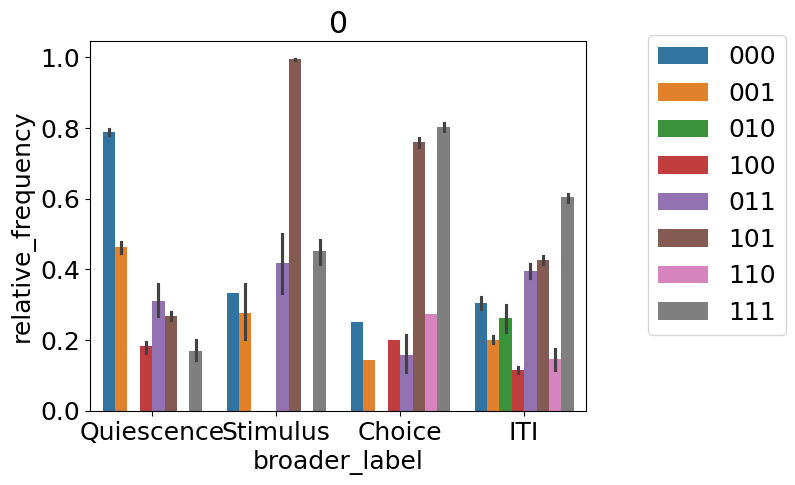

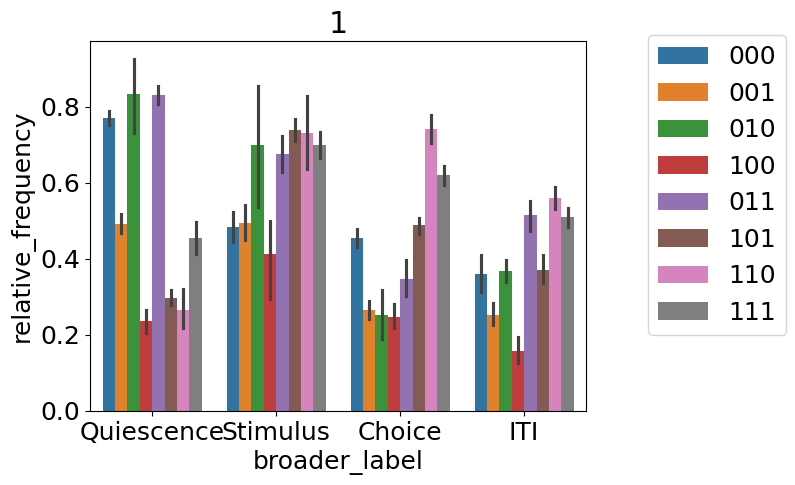

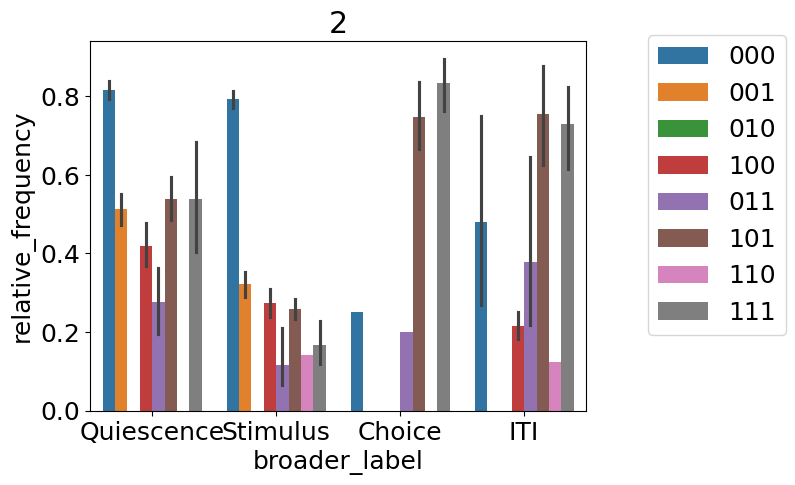

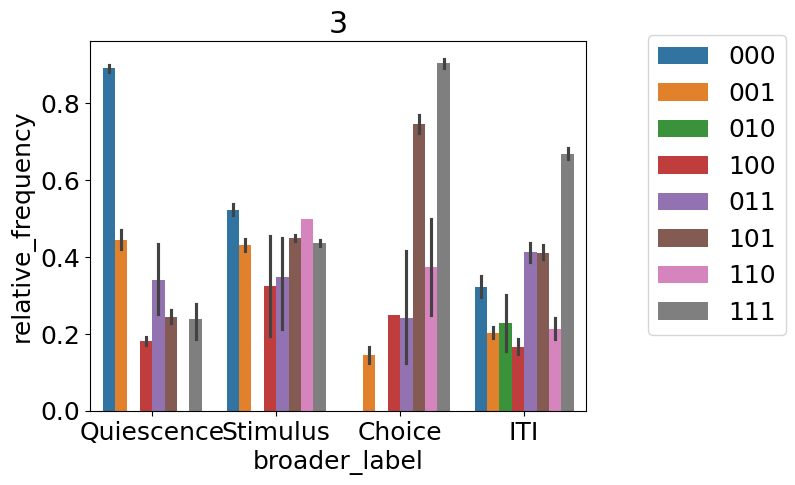

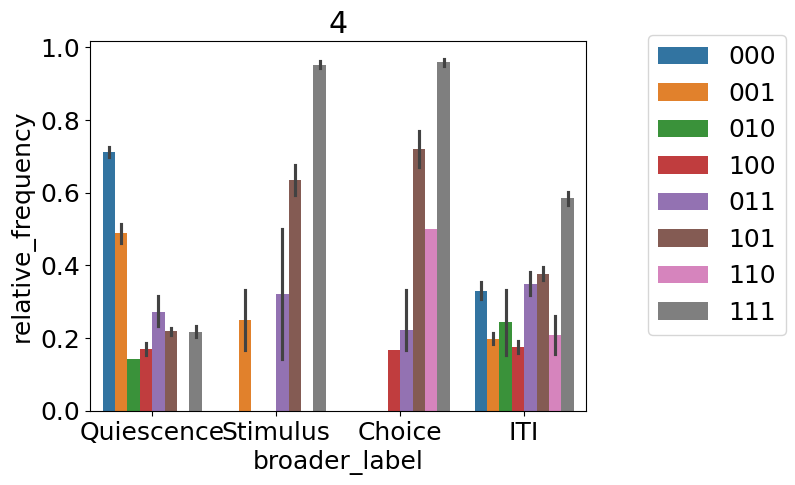

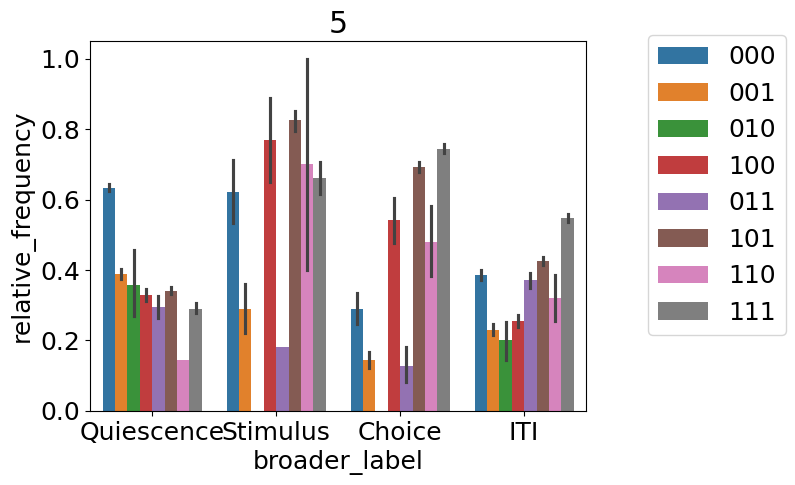

In [264]:
for c, cluster in enumerate(range(6)):
    use_data = df_cluster.loc[df_cluster['cluster']==cluster]
    sns.barplot(x='broader_label', y='relative_frequency', hue='identifiable_states', 
                order=['Quiescence', 'Stimulus', 'Choice', 'ITI'], 
                hue_order = ['000', '001', '010', '100', '011', '101', '110', '111'], data=use_data)
    plt.legend(bbox_to_anchor=(1.1, 1.05))
    plt.title(cluster)
    plt.show()